In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

from time import time
import numpy as np 
from numpy import savetxt, loadtxt, asarray
import matplotlib.pyplot as plt

from sklearn import metrics
from sklearn.cluster import KMeans
from sklearn.datasets import load_digits
from sklearn.decomposition import PCA
from sklearn.preprocessing import scale
import sklearn.preprocessing as preprocessing


from progressbar import ProgressBar
from tqdm import tqdm
pbar = ProgressBar()
tqdm.pandas()


In [2]:
path_raw_val = '/Users/roxanefischer/Desktop/single_path_nas/single-path-nas/HAS/data/good_data/parsed_nondups_val_3.csv'
path_raw_train = '/Users/roxanefischer/Desktop/single_path_nas/single-path-nas/HAS/data/good_data/parsed_nondups_train_3.csv'

In [3]:

train_hw = pd.read_csv(path_raw_train)
val_hw = pd.read_csv(path_raw_val)

y_train = np.array(train_hw["total_power"].tolist())
y_train=y_train.reshape(y_train.shape[0],-1)

y_val = np.array(val_hw["total_power"].tolist())
y_val=y_val.reshape(y_val.shape[0],-1)



In [4]:
data = pd.concat([train_hw , val_hw], ignore_index=True)

In [5]:
X_train_hw_param  = train_hw[['mac_num', 'mac_array_num', 'data_bits', 'sram_size', 'max_filter_size']]
X_train_hw_param['tot_mac'] = X_train_hw_param['mac_num']*X_train_hw_param['mac_array_num']

X_val_hw_param  = val_hw[['mac_num', 'mac_array_num', 'data_bits', 'sram_size', 'max_filter_size']]
X_val_hw_param['tot_mac'] = X_val_hw_param['mac_num']*X_val_hw_param['mac_array_num']

X_train_hw_param.head()

,mac_num,mac_array_num,data_bits,sram_size,max_filter_size,tot_mac
0,118.0,2.0,256.0,179968.0,2048.0,236.0
1,87.0,2.0,512.0,99968.0,2048.0,174.0
2,124.0,2.0,512.0,99968.0,3072.0,248.0
3,80.0,2.0,1024.0,99968.0,1024.0,160.0
4,86.0,2.0,512.0,60000.0,1536.0,172.0


In [6]:
train_hw.head()

,mac_num,mac_array_num,data_bits,sram_size,max_filter_size,G,C,B,J,name,bw_power,core_power,total_power
0,118.0,2.0,256.0,179968.0,2048.0,3.636011e+06,18770712.0,19987780.0,0.000533,0.0,79.951120,21.330414,101.281534
1,87.0,2.0,512.0,99968.0,2048.0,2.325259e+06,14362735.0,21849702.0,0.000570,0.0,87.398808,22.816285,110.215093
2,124.0,2.0,512.0,99968.0,3072.0,2.533459e+06,12739050.0,21849702.0,0.000543,0.0,87.398808,21.716202,109.115010
3,80.0,2.0,1024.0,99968.0,1024.0,2.327509e+06,12155422.0,21849702.0,0.000684,0.0,87.398808,27.343500,114.742308
4,86.0,2.0,512.0,60000.0,1536.0,1.728057e+06,16407889.0,28402776.0,0.000604,0.0,113.611104,24.174307,137.785411


# Low power < 100 : 69% dataset

<class 'numpy.ndarray'>


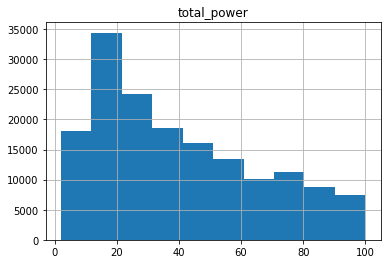

In [7]:
low_hist = data[(data["total_power"] < 100)].hist(column="total_power")
print(type(low_hist))
plt.savefig("low_hist.png")

# Middle power 100< < 1000 : 30% dataset

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a18bb11d0>]],
      dtype=object)

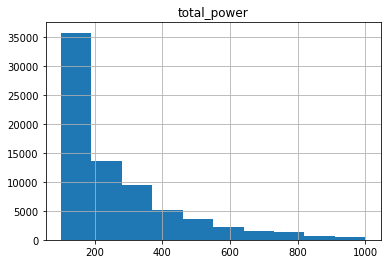

In [8]:
data[ (1000>data["total_power"]) &(data["total_power"]>=100) ].hist(column="total_power")


# High power > 1000 : 1,6% dataset

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1a1887ad68>]],
      dtype=object)

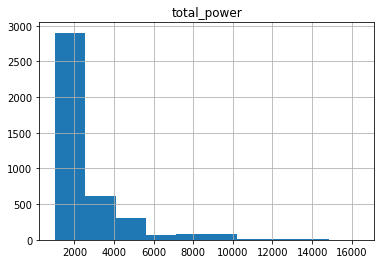

In [9]:
data[(data["total_power"] >= 1000)].hist(column="total_power")


# PCA (scaled)

([<matplotlib.axis.XTick at 0x1a188e6358>,
 <a list of 6 Text xticklabel objects>)

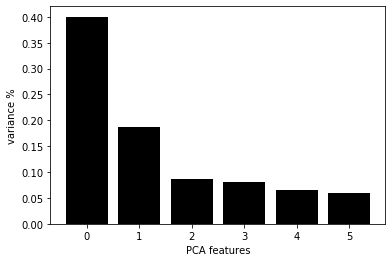

In [10]:
pca = PCA(n_components=6).fit(scale(data))
principalComponents = pca.fit_transform(scale(data))
PCA_components = pd.DataFrame(principalComponents)

features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(features)



# K-means

In [11]:
n_clusters = 10
n_samples = (X_train_hw_param).shape[0]
n_features = (X_train_hw_param).shape[1]



In [12]:
n_samples

215445

# Inv

In [13]:
def inv(x):
    return 1/(1+x)

inversed=True
if inversed : 
#nb_hw_param = 6
    nb_hw_param = 12
    X_train_hw_param['1/mac_num'] = X_train_hw_param['mac_num'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/mac_array_num'] = X_train_hw_param['mac_array_num'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/data_bits'] = X_train_hw_param['data_bits'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/sram_size'] = X_train_hw_param['sram_size'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/max_filter_size'] = X_train_hw_param['max_filter_size'].progress_apply(lambda x : inv(x))
    X_train_hw_param['1/tot_mac'] = X_train_hw_param['tot_mac'].progress_apply(lambda x : inv(x))


    X_val_hw_param['1/mac_num'] = X_val_hw_param['mac_num'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/mac_array_num'] = X_val_hw_param['mac_array_num'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/data_bits'] = X_val_hw_param['data_bits'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/sram_size'] = X_val_hw_param['sram_size'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/max_filter_size'] = X_val_hw_param['max_filter_size'].progress_apply(lambda x : inv(x))
    X_val_hw_param['1/tot_mac'] = X_val_hw_param['tot_mac'].progress_apply(lambda x : inv(x))




100%|██████████| 24274/24274 [00:00<00:00, 701178.60it/s]


In [14]:
scaler = preprocessing.StandardScaler().fit(X_train_hw_param)
X_train_hw_param_norm= scaler.transform(X_train_hw_param)
X_val_hw_param_norm = scaler.transform(X_val_hw_param )

In [15]:
pd.DataFrame(X_train_hw_param_norm).head()

,0,1,2,3,4,5,6,7,8,9,10,11
0,0.855641,-0.489793,-0.647015,0.529144,0.332994,-0.239695,-0.662872,0.706748,0.103602,-0.981619,-0.778893,-0.505309
1,0.300127,-0.489793,-0.258452,-0.373136,0.332994,-0.306012,-0.581406,0.706748,-0.569281,-0.066708,-0.778893,-0.411430
2,0.963160,-0.489793,-0.258452,-0.373136,1.196488,-0.226860,-0.673972,0.706748,-0.569281,-0.066708,-1.029986,-0.518079
3,0.174689,-0.489793,0.518673,-0.373136,-0.530500,-0.320987,-0.554381,0.706748,-0.906707,-0.066708,-0.026105,-0.380224
4,0.282208,-0.489793,-0.258452,-0.823915,-0.098753,-0.308151,-0.577812,0.706748,-0.569281,1.304303,-0.527882,-0.407281


In [16]:
type(train_hw)

pandas.core.frame.DataFrame

In [17]:
data_hw = pd.concat([pd.DataFrame(X_train_hw_param_norm), pd.DataFrame(X_val_hw_param_norm)], ignore_index=True)
#data_hw = pd.concat([train_hw , val_hw], ignore_index=True)

In [19]:
kmeans_not_reduced = KMeans(init='k-means++', n_clusters=n_clusters, n_init=10)
kmeans_not_reduced.fit(data_hw)
centroids_not_reduced = kmeans_not_reduced.cluster_centers_
#KMeans(init='random', n_clusters=n_digits, n_init=10)
savetxt('hw_centroids.csv', centroids_not_reduced, delimiter=',')

In [53]:
centroids_not_reduced[0]

array([ 1.60542086,  2.63460667,  0.36665458,  0.55113861,  0.32597336,
        3.83660044, -0.70839003, -1.96681428, -0.36668177, -0.47817473,
       -0.50042666, -0.75320719])

# Plot (PCA reduced)

In [47]:
reduced_data = PCA(n_components=2).fit_transform(scale(data_hw))


kmeans = KMeans(init='k-means++', n_clusters=n_clusters, n_init=10)
y_pred =kmeans.fit_predict(reduced_data)
centroids = kmeans.cluster_centers_



In [48]:
centroids

array([[-0.63218439, -0.28724348],
       [ 2.02999968, -0.65055519],
       [-2.60856151,  3.12115354],
       [ 0.65406077,  2.91099243],
       [ 2.83044337,  1.24464245],
       [ 0.15692781, -1.49610928],
       [-1.53045254, -1.23469078],
       [ 0.652581  ,  0.49901829],
       [ 4.92013192, -0.04569841],
       [-1.77312095,  0.79616787]])

In [49]:
(y_pred)

array([5, 0, 5, ..., 4, 4, 0], dtype=int32)

In [50]:
colors =iter(list(y_pred))

cols={
0: 'red',
1: 'green',
2: 'blue',
3: 'cyan',
4: 'magenta',
5: 'yellow',
6: 'black',
7 : 'darkgreen',
8: 'orange',
9:'darkblue',
}



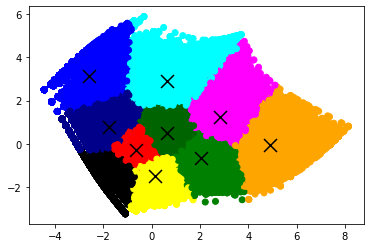

In [51]:
from itertools import *
plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=[cols[ind] for ind in y_pred])
# Plot the centroids as a white X
centroids = kmeans.cluster_centers_
plt.scatter(centroids[:, 0], centroids[:, 1],
            marker='x', s=169, linewidths=3,
            color='0', zorder=10)

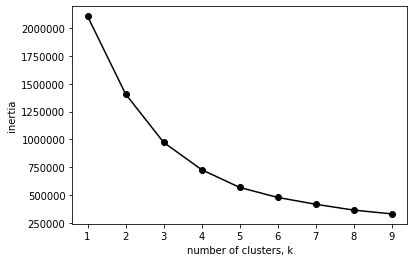

In [52]:
ks = range(1, 10)
inertias = []
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    model.fit(PCA_components.iloc[:,:3])
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
plt.plot(ks, inertias, '-o', color='black')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()